test:
1. get embedding
2. get discriminator
3. get off-manifolder
4. get jacobian of the chain
5. visualize jacobians

SHOULD TRY AN EASIER SWISS ROLL!

In [1]:
import wandb
import sys
import matplotlib.pyplot as plt
import scprep
import pandas as pd
sys.path.append('../src/')
# from diffusion import DiffusionModel
# from evaluate import get_results
from omegaconf import OmegaConf
# from main import load_data, make_model
import numpy as np
import os
import glob
import matplotlib.animation as animation
from matplotlib.animation import PillowWriter
import torch
from model2 import Autoencoder, Preprocessor, WDiscriminator
from off_manifolder import offmanifolder_maker
import magic
import torch
import pathlib
import copy

import wandb
import sys
import matplotlib.pyplot as plt
import scprep
import pandas as pd
from omegaconf import OmegaConf
import os
import glob
import numpy as np
import torch
from torch import nn
import torch.optim as optim
from geodesic import jacobian, velocity, CondCurve, GeodesicBridgeOverfit, GeodesicBridge
from plotly3d.plot import scatter, trajectories
import torch
from torch import nn
import pytorch_lightning as pl
from procrustes import Procrustes
from torch.utils.data import DataLoader, TensorDataset

In [2]:
main_sweep_id = '9d6r877r'
main_disc_sweep_id = 'sfw9zkm3'
main_data_name = 'swissroll_none_0'
main_weights_cycle = 1.
main_dimensions_latent = 5

wandb.login()
api = wandb.Api()

entity = "xingzhis"
project = "dmae"
sweep_id = main_sweep_id
sweep = api.sweep(f"{entity}/{project}/{sweep_id}")
# Initialize an empty list to store run data
runs_data = []

# Iterate through each run in the sweep
for run in sweep.runs:
    # Extract metrics and configs
    metrics = run.summary._json_dict
    configs = run.config
    
    # Combine metrics and configs, and add run ID
    combined_data = {**metrics, **configs, "run_id": run.id}
    
    # Append the combined data to the list
    runs_data.append(combined_data)

# Create a DataFrame from the runs data
df = pd.DataFrame(runs_data)

data_name = main_data_name
# run_ids = df[(df['data.name'] == data_name) & (df['cfg/loss/weights/cycle'] == 1.) & (df['cfg/dimensions/latent'] == 3)]['run_id']
run_ids = df[(df['data.name'] == data_name) & (df['loss.weights.cycle'] == main_weights_cycle) & (df['dimensions.latent'] == main_dimensions_latent)]['run_id']
assert len(run_ids) == 1
run_id = run_ids.iloc[0]
run = api.run(f"{entity}/{project}/{run_id}")
# run = api.run(f"{entity}/{project}/{run_id}")
folder_path = '../src/wandb/'
cfg = OmegaConf.create(run.config)
folder_list = glob.glob(f"{folder_path}*{run.id}*")
ckpt_files = glob.glob(f"{folder_list[0]}/files/*.ckpt")
ckpt_path = ckpt_files[0]
# cfg.data.root = '../' + cfg.data.root
model = Autoencoder.load_from_checkpoint(ckpt_path)
data = np.load(f"{cfg.data.root}/{cfg.data.name}{cfg.data.filetype}", allow_pickle=True)
with torch.no_grad():
    model.eval()
    x = torch.tensor(data['data'], dtype=torch.float32, device=model.device)
    z = model.encoder(x)
    xh = model.decoder(z)
    zhh = model.encoder(xh)
zc = z.cpu().numpy()
# fig = scatter(zc, s=2, alpha=0.2, title='latent', filename=f'{results_path}/latent.html')
# wandb.log({"latent": wandb.Plotly(fig)})
# fig = scatter(zhh, s=2, alpha=0.2, title='latent_reembedd', filename=f'{results_path}/latent_reembedded.html')
# wandb.log({"latent_reembedded": wandb.Plotly(fig)})
# fig = scatter(x, s=2, alpha=0.2, title='data', filename=f'{results_path}/data.html')
# wandb.log({"data": wandb.Plotly(fig)})
# fig = scatter(xh, s=2, alpha=0.2, title='reconstruction', filename=f'{results_path}/reconstruction.html')
# wandb.log({"reconstruction": wandb.Plotly(fig)})

sweep_id = main_disc_sweep_id
sweep = api.sweep(f"{entity}/{project}/{sweep_id}")
# Initialize an empty list to store run data
runs_data = []

# Iterate through each run in the sweep
for run in sweep.runs:
    # Extract metrics and configs
    metrics = run.summary._json_dict
    configs = run.config
    
    # Combine metrics and configs, and add run ID
    combined_data = {**metrics, **configs, "run_id": run.id}
    
    # Append the combined data to the list
    runs_data.append(combined_data)

# Create a DataFrame from the runs data
df = pd.DataFrame(runs_data)
run_ids = df[(df['data.name'] == data_name) & (df['loss.weights.pos1'] == 1.)][['run_id']]
assert len(run_ids) == 1
run_id = run_ids.iloc[0]
run = api.run(f"{entity}/{project}/{run_ids.iloc[0].values[0]}")
folder_path = '../src/wandb/'
cfg = OmegaConf.create(run.config)
folder_list = glob.glob(f"{folder_path}*{run.id}*")
ckpt_files = glob.glob(f"{folder_list[0]}/files/*.ckpt")
ckpt_path = ckpt_files[0]
# cfg.data.root = '../' + cfg.data.root
wd = WDiscriminator.load_from_checkpoint(ckpt_path)
data = np.load(f"{cfg.data.root}/{cfg.data.name}{cfg.data.filetype}", allow_pickle=True)
with torch.no_grad():
    wd.eval()
    x_disc = torch.tensor(data['data'], dtype=torch.float32, device=wd.device)
    probab = wd(x_disc).flatten()
    z = model.encoder(x_disc)

# title = f'{data_name} {noise_type} {noise_level} {dist_mask}'
# scatter(zc, data['mask_x'], s=2, alpha=0.2, title=title, filename=filename).show()
# scatter(zhh, data['mask_x'], s=2, alpha=0.2, title=title, filename=filename).show()
scatter(x_disc, data['mask_x'], s=2, alpha=0.2, title=f'{data_name}: input').show()
scatter(x_disc, probab, s=2, alpha=0.2, title=f'{data_name}: probability').show()#, filename='hsphere_disc_prob.html').show()
scatter(x_disc, probab > 0.5, s=2, alpha=0.2, title=f'{data_name}: classification').show()

# if plot_recon:
#     title = f'[RECON] {title}'
#     if savefolder is not None:
#         filename = f"{savefolder}/{title1}.html"
#     # scatter(xh, data['mask_x'], s=2, alpha=0.2, title=title1, filename=filename).show()


Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: xingzhis. Use `wandb login --relogin` to force relogin
/gpfs/gibbs/pi/krishnaswamy_smita/xingzhi/.conda_envs/geosink/lib/python3.11/site-packages/pytorch_lightning/utilities/parsing.py:269: UserWarning: Attribute 'preprocessor' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['preprocessor'])`.
  rank_zero_warn(
/gpfs/gibbs/pi/krishnaswamy_smita/xingzhi/.conda_envs/geosink/lib/python3.11/site-packages/pytorch_lightning/utilities/parsing.py:269: UserWarning: Attribute 'preprocessor' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['preprocessor'])`.
  rank_zero_warn(


In [3]:
cfg.data.root

'../data/gt_geodesic/disc/'

In [4]:
df[['data.name', 'loss.weights.pos1']]

,data.name,loss.weights.pos1
0,swissroll_5_0,1
1,hemisphere_5_0,0
2,hemisphere_5_0,1
3,swissroll_5_0,0
4,swissroll_none_0,1
5,swissroll_50_0,1
6,swissroll_50_0,0
7,swissroll_15_0.1,1
8,swissroll_15_0,1
9,swissroll_15_0.1,0


In [5]:
max_prob = probab.max()

(array([   4.,   12.,   32.,  113.,  194.,  509.,  193.,  310.,  486.,
        3547.]),
 array([0.        , 0.1       , 0.2       , 0.30000001, 0.40000001,
        0.5       , 0.60000002, 0.69999999, 0.80000001, 0.89999998,
        1.        ]),
 <BarContainer object of 10 artists>)

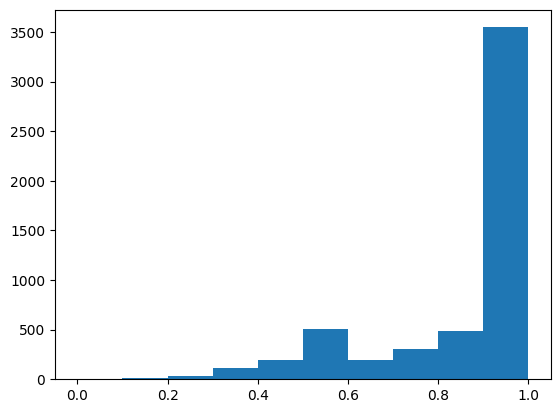

In [6]:
plt.hist((probab-probab.min())/(probab.max()-probab.min()))

In [7]:
med = probab.quantile(1-data['mask_x'].mean())

(array([   4.,   11.,   32.,   85.,  199.,  495.,  163.,  228.,  476.,
        3707.]),
 array([0.        , 0.1       , 0.2       , 0.30000001, 0.40000001,
        0.5       , 0.60000002, 0.69999999, 0.80000001, 0.89999998,
        1.        ]),
 <BarContainer object of 10 artists>)

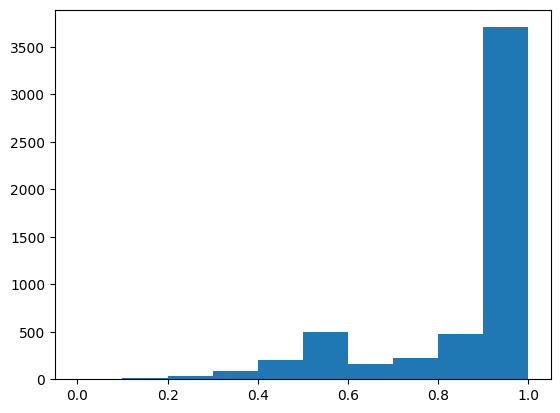

In [8]:
plt.hist((torch.clamp(probab, max=med) - probab.min())/(med-probab.min()))

In [9]:
# data_gt = np.load(f"../data/gt_geodesic_w_geod_2/{data_name}.npz", allow_pickle=True)
data_gt=data
xbatch = torch.tensor(data_gt['start_points'], dtype=x.dtype, device=x.device)
xendbatch = torch.tensor(data_gt['end_points'], dtype=x.dtype, device=x.device)

# xbatch = model.encoder.preprocessor.normalize(xbatch)
# xendbatch = model.encoder.preprocessor.normalize(xendbatch)
ids = torch.zeros((xbatch.size(0),1))
# ids = torch.eye((xbatch.size(0)))

dataset = TensorDataset(xbatch, xendbatch, ids)
dataloader = DataLoader(dataset, batch_size=len(z), shuffle=True)

In [10]:
def offmanifolder_maker(
    encoder_, 
    discriminator_, 
    disc_factor = 4,
    max_prob=1.
):
    def ofm_(x):
        z = encoder_(x)
        weighting_factor1 = (max_prob-discriminator_(x))/max_prob*disc_factor
        weighting_factor2 = torch.exp(weighting_factor1)
        return torch.cat([z * (weighting_factor2.reshape(-1,1)), (weighting_factor2).unsqueeze(1).repeat(1, 1)], dim=1)
    return ofm_


In [11]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)
wd = wd.to(device)
med = probab.quantile(1-data['mask_x'].mean()).to(device)
# discriminator = discriminator.to(device)
for param in model.encoder.parameters():
    param.requires_grad = False
for param in wd.parameters():
    param.requires_grad = False
enc_func = lambda x: model.encoder(x)
# disc_func = lambda x: wd(x).flatten()
# disc_func_pen = lambda x: 1 - (max_prob - disc_func(x))
# discriminator_func_for_grad = lambda x: wd(x)
# discriminator_func_for_grad = lambda x: discriminator.positive_proba(x).reshape(-1,1)
disc_func = lambda x: (wd(x).flatten()-probab.min())/(probab.max()-probab.min())
# disc_func = lambda x: (torch.clamp(wd(x).flatten(), max=med) - probab.min())/(med-probab.min())
# disc_func_pen = disc_func
# discriminator_func_for_grad = lambda x: (wd(x)-probab.min())/(probab.max()-probab.min())
ofm = offmanifolder_maker(enc_func, disc_func, disc_factor=1, max_prob=max_prob)
gbmodel = GeodesicBridgeOverfit(
    func=ofm,
    # func = enc_func,
    # discriminator_func=disc_func_pen,
    # discriminator_func_for_grad=discriminator_func_for_grad,
    input_dim=x.size(1), 
    hidden_dim=64, 
    scale_factor=1, 
    symmetric=True, 
    num_layers=3, 
    n_tsteps=20, 
    lr=1e-4, 
    weight_decay=1e-3,
    discriminator_weight=0.,
    discriminator_func_for_grad_weight=0.,
    id_dim=1,
    id_emb_dim=1,
    density_weight=0.,
    length_weight=1.,
)

In [12]:
gbmodel.lr=1e-3
# gbmodel.discriminator_func_for_grad_weight=0.,
trainer = pl.Trainer(
    max_epochs=400,
    log_every_n_steps=20,
    accelerator='cuda',
)
trainer.fit(gbmodel, dataloader)
# gbmodel.lr=1e-3
# # gbmodel.discriminator_func_for_grad_weight=1.
# gbmodel.multiply_loss = True
# trainer = pl.Trainer(
#     max_epochs=400,
#     log_every_n_steps=20,
#     accelerator='cuda',
# )
# trainer.fit(gbmodel, dataloader)

/gpfs/gibbs/pi/krishnaswamy_smita/xingzhi/.conda_envs/geosink/lib/python3.11/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning:

The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /gpfs/gibbs/pi/krishnaswamy_smita/xingzhi/.conda_env ...

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/gpfs/gibbs/pi/krishnaswamy_smita/xingzhi/.conda_envs/geosink/lib/python3.11/site-packages/pytorch_lightning/trainer/configuration_validator.py:108: PossibleUserWarning:

You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.

You are using a CUDA device ('NVIDIA RTX A5000') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off pre

Training: 0it [00:00, ?it/s]

`Trainer.fit` stopped: `max_epochs=400` reached.


In [13]:
x0, x1, ids = next(iter(dataloader))
x0 = x0.to(device)
x1 = x1.to(device)
ids = ids.to(device)
x = x.to(device)
gbmodel = gbmodel.to(device)
with torch.no_grad():
    xhat = gbmodel(x0, x1, gbmodel.ts.to(device), ids)

xshape = xhat.shape
xflatten = xhat.flatten(0,1)
with torch.no_grad():
    zhat_flatten = model.encoder(xflatten)
    zhat = zhat_flatten.reshape(xshape[0], xshape[1], -1)
    z0 = model.encoder(x0)
    z1 = model.encoder(x1)

    fig = scatter(x.cpu().numpy(), s=2)
    fig = scatter(x0.detach().cpu().numpy(), s=10, fig=fig)
    fig = scatter(x1.detach().cpu().numpy(), s=10, fig=fig)
    fig = trajectories(xhat.detach().cpu().numpy(), s=5, fig=fig, title='Geodesic', filename='geodesic_ofm.html')
    fig.show()

In [14]:
x0, x1, ids = next(iter(dataloader))
x0 = x0.to(device)
x1 = x1.to(device)
ids = ids.to(device)
with torch.no_grad():
    xhat = gbmodel(x0, x1, gbmodel.ts, ids)
    xconc = xhat.flatten(0, 1)
    probs = disc_func(xconc)
scatter(xconc.cpu().numpy(), probs.cpu().numpy(), s=2)

In [15]:
x0, x1, ids = next(iter(dataloader))
x0 = x0.to(device)
x1 = x1.to(device)
ids = ids.to(device)
with torch.no_grad():
    xconc = x_disc.to(device)
    probs = disc_func(xconc)
scatter(xconc.cpu().numpy(), probs.cpu().numpy(), s=2)
scatter(xconc.cpu().numpy(), probs.cpu().numpy(), s=2)

In [16]:
x0, x1, ids = next(iter(dataloader))
x0 = x0.to(device)
x1 = x1.to(device)
ids = ids.to(device)
with torch.no_grad():
    xhat = gbmodel(x0, x1, gbmodel.ts, ids)
    xconc = xhat.flatten(0, 1)
    xconc = torch.cat([xconc, x_disc.to(device)])

    probs = disc_func(xconc)
scatter(xconc.cpu().numpy(), probs.cpu().numpy(), s=2)

In [17]:
x0, x1, ids = next(iter(dataloader))
x0 = x0.to(device)
x1 = x1.to(device)
ids = ids.to(device)
with torch.no_grad():
    xconc = x.to(device)
    probs = disc_func(xconc)
scatter(xconc.cpu().numpy(), probs.cpu().numpy(), s=2, force_continuous=True)

In [18]:
x0, x1, ids = next(iter(dataloader))
x0 = x0.to(device)
x1 = x1.to(device)
ids = ids.to(device)
x = x.to(device)
gbmodel = gbmodel.to(device)
with torch.no_grad():
    xhat = gbmodel(x0, x1, gbmodel.ts.to(device), ids)

xshape = xhat.shape
xflatten = xhat.flatten(0,1)
with torch.no_grad():
    zhat_flatten = model.encoder(xflatten)
    zhat = zhat_flatten.reshape(xshape[0], xshape[1], -1)
    z0 = model.encoder(x0)
    z1 = model.encoder(x1)
    prob_x = disc_func(x).flatten()

    fig = scatter(x.cpu().numpy(), prob_x.cpu().numpy(), s=2, force_continuous=True)
    fig = scatter(x0.detach().cpu().numpy(), s=10, fig=fig)
    fig = scatter(x1.detach().cpu().numpy(), s=10, fig=fig)
    fig = trajectories(xhat.detach().cpu().numpy(), s=5, fig=fig, title='Geodesic', filename='geodesic_ofm.html')
    fig.show()

In [19]:
true_geod = torch.tensor(data_gt['geodesics'], dtype=torch.float32)

In [20]:
fig = scatter(x.cpu().numpy(), s=2)
fig = scatter(x0.detach().cpu().numpy(), s=10, fig=fig)
fig = scatter(x1.detach().cpu().numpy(), s=10, fig=fig)
fig = trajectories(xhat.detach().cpu().numpy(), s=5, fig=fig)
fig = trajectories(true_geod.permute(1,0,2).detach().cpu().numpy(), s=5, fig=fig)
fig.show()

In [21]:
# batch = next(iter(dataloader))
# x0, x1, ids = batch
x0 = xbatch
x1 = xendbatch
ids = ids
x0 = x0.to(device)
x1 = x1.to(device)
ids = ids.to(device)

def cc_func(x0, x1, t):
    return gbmodel.cc(x0, x1, t, ids)
vectors = velocity(cc_func, gbmodel.ts, x0, x1)
cc_pts = gbmodel.cc(x0, x1, gbmodel.ts, ids)
vectors_flat = vectors.flatten(0,1)
cc_pts_flat = cc_pts.flatten(0, 1)
jac_flat = jacobian(enc_func, cc_pts_flat)
length_all = torch.sqrt((torch.einsum("nij,nj->ni", jac_flat, vectors_flat)**2).sum(axis=1))
length_all = length_all.reshape(vectors.shape[0], vectors.shape[1])
length_pred = length_all.mean(axis=0)

with torch.no_grad():
    geods = (cc_pts_flat).reshape(cc_pts.shape)
    length2 = torch.sqrt(torch.diff(geods, axis=0)**2).sum(axis=-1).sum(axis=0)

In [22]:
length_pred

tensor([2.9732, 3.5034, 2.5990, 2.5789, 7.2401, 0.9175, 4.9390, 1.3859, 2.3146,
        2.6621, 2.3152, 2.7605, 3.8946, 2.4496, 4.0217, 2.0729, 4.2411, 3.9583,
        5.5896, 7.1337], device='cuda:0', grad_fn=<MeanBackward1>)

In [23]:
length2

tensor([28.5120, 25.1589, 20.2216, 20.2046, 34.9982, 11.0282, 18.5774, 10.5171,
        27.7078, 25.4306, 23.4231, 18.9736, 26.8337, 18.1607, 37.3230, 15.8858,
        16.0248, 29.5944, 37.7509, 43.0301], device='cuda:0')

In [24]:
gt_lengths = data_gt['geodesic_lengths']

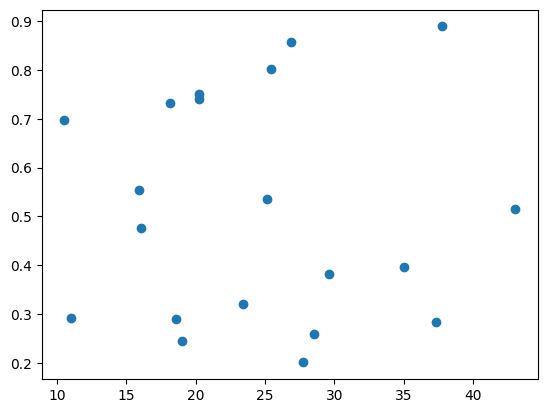

In [25]:
plt.scatter(length2.cpu().numpy(), gt_lengths)

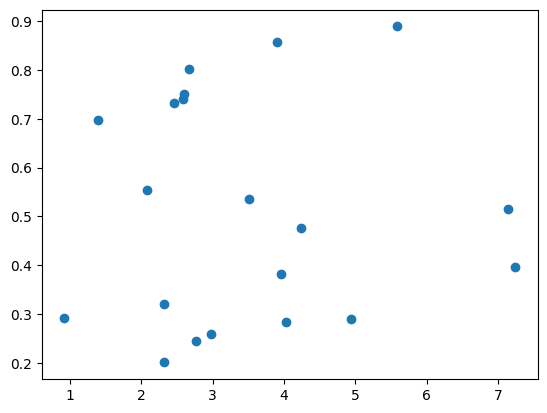

In [26]:
plt.scatter(length_pred.detach().cpu().numpy(), gt_lengths)

In [27]:
lengthgt = torch.sqrt(torch.diff(true_geod.permute(1,0,2), axis=0)**2).sum(axis=-1).sum(axis=0)

In [28]:
torch.sqrt(torch.diff(true_geod.permute(1,0,2), axis=0)**2).sum(axis=-1).sum(axis=0)

tensor([30.6826, 74.6366, 67.1411, 17.3494, 53.1350, 11.0344, 18.6653, 80.1370,
        26.6655, 26.1829, 24.5988, 18.9683, 92.6424, 17.0671, 36.4977, 14.4758,
        42.8093, 31.3682, 64.4183, 54.5974])

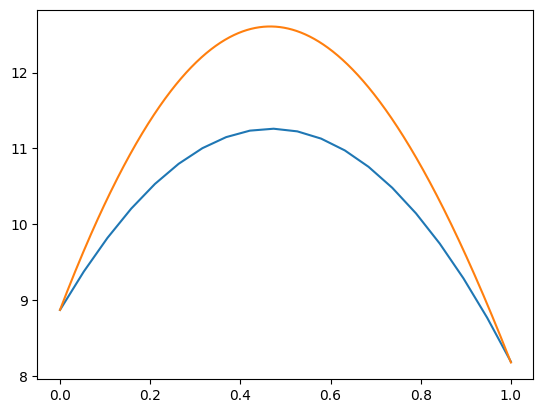

In [29]:
t = gbmodel.ts
t2 = np.linspace(0,1,true_geod.shape[1])
i = 0
j = 0
plt.plot(t.cpu().numpy(), geods[:,i,j].detach().cpu().numpy())
plt.plot(t2, true_geod[i,:,j].detach().cpu().numpy())

In [30]:
fig = scatter(x.cpu().numpy(), s=2)
fig = scatter(x0.detach().cpu().numpy(), s=10, fig=fig)
fig = scatter(x1.detach().cpu().numpy(), s=10, fig=fig)
fig = trajectories(xhat[:,[i],:].detach().cpu().numpy(), s=5, fig=fig)
fig = trajectories(true_geod.permute(1,0,2)[:,[i],:].detach().cpu().numpy(), s=5, fig=fig)
fig.show()

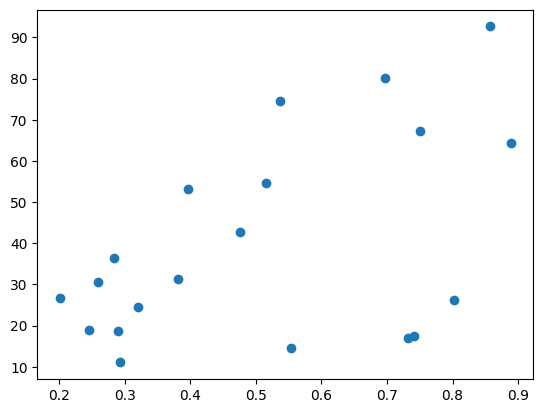

In [31]:
plt.scatter(gt_lengths, lengthgt)

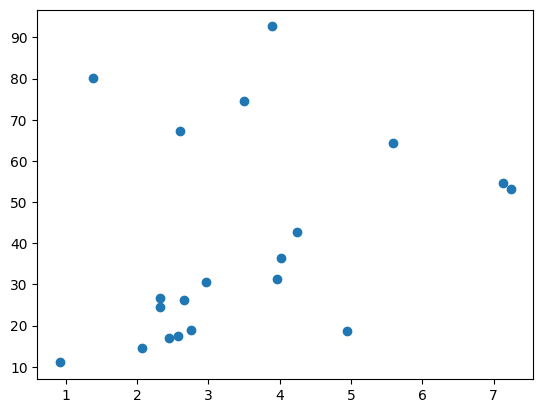

In [32]:
plt.scatter(length_pred.detach().cpu().numpy(), lengthgt)

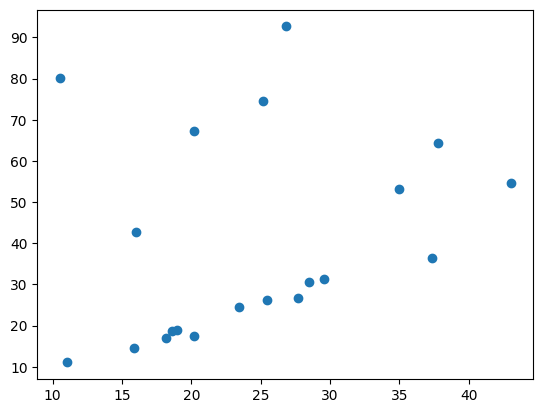

In [33]:
plt.scatter(length2.detach().cpu().numpy(), lengthgt)

In [34]:
def _distance_to_geodesic_criterion(predicted_geodesic, true_geodesic):
    # the inputs here are single samples from a geodesic; should be shape num_samples x num_dims
    # for each input point, we want the closest distance to any point on the true geodesic using the euclidean distance, torch.cdist
    D = torch.cdist(predicted_geodesic, true_geodesic)
    min_dists_to_true_geodesic = D.min(dim=1)[0]
    # we take the mean of the squared distances
    return torch.abs(min_dists_to_true_geodesic).mean()
def distance_to_geodesic_criterion(
    predicted_geodesic:torch.Tensor, # size num_geodesics x num_samples x num_dims
    true_geodesic:torch.Tensor, # size num_geodesics num_samples x num_dims. But it's okay if the num_samples are different
    lengths=1.,
    ):
    """
    Mean of the squared distances from each predicted point to the closest point on the true geodesic
    """
    dists = []
    for i in range(predicted_geodesic.shape[0]):
        dists.append(_distance_to_geodesic_criterion(predicted_geodesic[i], true_geodesic[i]))
    dists = torch.stack(dists)
    dists = dists / lengths
    return dists.mean()

def distances_to_geodesic(
    predicted_geodesic:torch.Tensor, # size num_geodesics x num_samples x num_dims
    true_geodesic:torch.Tensor, # size num_geodesics num_samples x num_dims. But it's okay if the num_samples are different
    ):
    """
    Mean of the squared distances from each predicted point to the closest point on the true geodesic
    """
    dists = []
    for i in range(predicted_geodesic.shape[0]):
        dists.append(_distance_to_geodesic_criterion(predicted_geodesic[i], true_geodesic[i]))
    dists = torch.stack(dists)
    return dists

In [35]:
dist2geod = distance_to_geodesic_criterion(geods.permute(1,0,2).cpu(), true_geod, lengthgt).detach().numpy()

In [36]:
dists = distances_to_geodesic(geods.permute(1,0,2).cpu(), true_geod).detach().numpy()

In [37]:
dists

array([1.3265722 , 3.3389256 , 3.2017677 , 1.2597624 , 6.419137  ,
       0.05893502, 0.6501637 , 1.3121833 , 0.6966963 , 1.0869334 ,
       0.41201997, 1.1375097 , 3.0362778 , 0.33710867, 0.99566525,
       0.73077583, 2.0979545 , 2.0308807 , 4.7509093 , 7.1689973 ],
      dtype=float32)

In [38]:
dist2geod

array(0.04895408, dtype=float32)

In [39]:
np.corrcoef(length_pred.detach().cpu().numpy(), lengthgt.detach().cpu().numpy())

array([[1.        , 0.31732684],
       [0.31732684, 1.        ]])

In [40]:
((length.detach().cpu().numpy() - lengthgt.detach().cpu().numpy())**2).mean()

NameError: name 'length' is not defined

In [ ]:
np.corrcoef(length.detach().cpu().numpy(), length2.detach().cpu().numpy())

: 

In [ ]:
np.corrcoef(length.detach().cpu().numpy(), lengthgt.detach().cpu().numpy())

: 

In [ ]:
def pairwise_geodesic(
                a, # Coordinates in ambient space
                b, 
                r,
                ts = None, # length of this is the number of times to sample along the geodesic
                tolerance = 0.02
                ):
    """
    Returns geodesic in ambient space between points a and b.
    """
    # if a and b are 2d, convert to 1d
    a = torch.squeeze(a)
    b = torch.squeeze(b)
    # get a linspace line between the two points
    if ts is None:
        ts = torch.linspace(0,1,20)
    g = torch.zeros(len(ts), 3)
    g[:,0] = torch.linspace(a[0], b[0], len(ts))
    g[:,1] = torch.linspace(a[1], b[1], len(ts))
    g[:,2] = torch.linspace(a[2], b[2], len(ts))
    # normalize each row in g to have unit length
    g = g / torch.linalg.norm(g, dim=1, keepdim=True)
    
    # compute length of geodesic
    angle = torch.linalg.norm(torch.cross(a, b, dim=-1))/r**2
    length = r * angle

    return g, length

: 

In [ ]:
# r = 1

: 

In [ ]:
geods_gt, lengths_gt = [], []
for i in range(xbatch.shape[0]):
    points, length = pairwise_geodesic(xbatch[i].cpu(), xendbatch[i].cpu(), r=1, ts = np.linspace(0,1,1000),tolerance=0.02)
    geods_gt.append(points)
    lengths_gt.append(length)
geods_gt = torch.stack(geods_gt).permute(1,0,2)
lengths_gt = torch.tensor(lengths_gt)

: 

In [ ]:
np.corrcoef(length2.detach().cpu().numpy(), lengths_gt.detach().cpu().numpy())

: 

In [ ]:
np.corrcoef(length2.detach().cpu().numpy(), lengthgt.detach().cpu().numpy())

: 

In [ ]:
plt.scatter(length2.detach().cpu().numpy(), lengths_gt)

: 

In [ ]:
plt.scatter(length2.detach().cpu().numpy(), lengthgt)

: 

In [ ]:
fig = scatter(x.cpu().numpy(), s=2)
fig = scatter(x0.detach().cpu().numpy(), s=10, fig=fig)
fig = scatter(x1.detach().cpu().numpy(), s=10, fig=fig)
fig = trajectories(xhat[:,[i],:].detach().cpu().numpy(), s=5, fig=fig)
fig = trajectories(geods_gt[:,[i],:].detach().cpu().numpy(), s=5, fig=fig)
fig.show()

: 

: 